# Load Data

In [ ]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1drXpei5St8ONQdHPzmw006P63O-6JbFw' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1drXpei5St8ONQdHPzmw006P63O-6JbFw" -O data.zip && rm -rf /tmp/cookies.txt

--2023-09-18 20:49:52--  https://docs.google.com/uc?export=download&confirm=&id=1drXpei5St8ONQdHPzmw006P63O-6JbFw
Resolving docs.google.com (docs.google.com)... 142.251.2.102, 142.251.2.139, 142.251.2.100, ...
Connecting to docs.google.com (docs.google.com)|142.251.2.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-08-14-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/uh86nldmlc371hlg691dur7uluus70ck/1695070200000/08719684158669863987/*/1drXpei5St8ONQdHPzmw006P63O-6JbFw?e=download&uuid=2733f469-3e69-4b0d-ad4b-0c888fcca785 [following]
--2023-09-18 20:50:10--  https://doc-08-14-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/uh86nldmlc371hlg691dur7uluus70ck/1695070200000/08719684158669863987/*/1drXpei5St8ONQdHPzmw006P63O-6JbFw?e=download&uuid=2733f469-3e69-4b0d-ad4b-0c888fcca785
Resolving doc-08-14-docs.googleusercontent.com (doc-08-14-docs.googleusercontent.com)... 142.251.2.132, 2607:f

In [ ]:
!unzip /content/data

Archive:  /content/data.zip
   creating: data/
  inflating: data/school.dbf         
  inflating: data/school.prj         
  inflating: data/school.shp         
  inflating: data/school.shx         
 extracting: data/telecom.cpg        
  inflating: data/telecom.dbf        
  inflating: data/telecom.prj        
  inflating: data/telecom.qmd        
  inflating: data/telecom.shp        
  inflating: data/telecom.shx        
 extracting: data/uttarakhand_admin_1.cpg  
  inflating: data/uttarakhand_admin_1.dbf  
  inflating: data/uttarakhand_admin_1.prj  
  inflating: data/uttarakhand_admin_1.qmd  
  inflating: data/uttarakhand_admin_1.shp  
  inflating: data/uttarakhand_admin_1.shx  


# Visualize

### Now we visualize the School data (from OSM) and Telecom data (from [OpenCelliD](https://www.opencellid.org/)) in folium

In [ ]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

# Replace 'your_admin_boundary.shp', 'your_shapefile.shp', and 'telecom.shp'
# with the actual filenames of your shapefiles
admin_boundary_path = '/content/data/uttarakhand_admin_1.shp'
school_shapefile_path = '/content/data/school.shp'
telecom_shapefile_path = '/content/data/telecom.shp'

# Read the administrative boundary shapefile, school shapefile, and telecom shapefile
admin_boundary_gdf = gpd.read_file(admin_boundary_path)
school_gdf = gpd.read_file(school_shapefile_path)
telecom_gdf = gpd.read_file(telecom_shapefile_path)

# Calculate the center and zoom to fit both shapefiles
map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]
map_zoom = 8.5  # Adjust the zoom level as needed

# Create a Folium map centered at the calculated center with the specified zoom
m = folium.Map(location=map_center, zoom_start=map_zoom)

# Create FeatureGroups for schools, administrative boundary, and telecom
school_layer = folium.FeatureGroup(name='Schools')  # Layer for schools
boundary_layer = folium.FeatureGroup(name='Admin Boundary')  # Layer for admin boundary
telecom_layer = folium.FeatureGroup(name='Telecom')  # Layer for telecom

# Define a function to format the attributes for display in the popup
def format_popup_attributes(attributes):
    popup_html = '<table>'
    for key in ['osm_id', 'osm_type', 'amenity', 'name']:
        value = attributes.get(key, 'N/A')
        popup_html += f'<tr><td>{key}</td><td>{value}</td></tr>'
    popup_html += '</table>'
    return folium.Popup(html=popup_html)

# Add the administrative boundary GeoDataFrame to the boundary layer
folium.GeoJson(admin_boundary_gdf).add_to(boundary_layer)

# Add the GeoDataFrame for your shapefile as markers with popups to the school layer
for idx, feature in school_gdf.iterrows():
    attributes = feature.to_dict()
    popup = format_popup_attributes(attributes)
    centroid = feature.geometry.centroid
    folium.Marker(
        location=[centroid.y, centroid.x],
        popup=popup
    ).add_to(school_layer)

# Create a MarkerCluster for the telecom points
marker_cluster = MarkerCluster().add_to(telecom_layer)

# Add the telecom points to the MarkerCluster
for idx, feature in telecom_gdf.iterrows():
    attributes = feature.to_dict()
    popup = format_popup_attributes(attributes)
    centroid = feature.geometry.centroid
    folium.Marker(
        location=[centroid.y, centroid.x],
        popup=popup,
    ).add_to(marker_cluster)

# Add FeatureGroups to the map
school_layer.add_to(m)
boundary_layer.add_to(m)
telecom_layer.add_to(m)

# Add Layer Control to the map
folium.LayerControl(collapsed=False).add_to(m)  # Use collapsed=False to expand the control by default

# Display the map
m

<ipython-input-3-dd31e8a59fc4>:17: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]


# Hypothesis
#### Considering School amenities as target points and telecom points as source of internet (working only in Uttarakhand,India). Inside a buffer of 10 km (considering students live approximately in this much area only) if multiple telecom reside, that means the school has got great connectivity to Internet (NOTE: this study was done in the time of COVID-19).

no. of telecoms in the buffer area (on a avg. telecom can only cover 1 km of area)
*   0-10 = Very poor connectivity
*   10-100 = Poor connectivity  
*   100-1000 = Average connectivity
*   1000-3000 = Good connectivity
*   3000-5000 = Very good connectivity
*   beyond 5000 = Excellent connectivity

(NOTE: this range also considers the high bandwidth need for video conferencing, that is why such high number of telecom towers in a 10 km area)

### Buffer analysis to calculate number of telecom points in 10 km radius of schools

In [ ]:
import geopandas as gpd
import folium
from shapely.geometry import Point

# Replace 'your_admin_boundary.shp', 'your_shapefile.shp', and 'telecom.shp'
# with the actual filenames of your shapefiles
admin_boundary_path = '/content/data/uttarakhand_admin_1.shp'
school_shapefile_path = '/content/data/school.shp'
telecom_shapefile_path = '/content/data/telecom.shp'
buffer_output_path = '/content/school_buffers.shp'

# Read the administrative boundary shapefile, school shapefile, and telecom shapefile
admin_boundary_gdf = gpd.read_file(admin_boundary_path)
school_gdf = gpd.read_file(school_shapefile_path)
telecom_gdf = gpd.read_file(telecom_shapefile_path)

# Calculate the center and zoom to fit both shapefiles
map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]
map_zoom = 8.5  # Adjust the zoom level as needed

# Create a Folium map centered at the calculated center with the specified zoom
m = folium.Map(location=map_center, zoom_start=map_zoom)

# Create a FeatureGroup for schools, administrative boundary, and telecom
school_layer = folium.FeatureGroup(name='Schools')  # Layer for schools
boundary_layer = folium.FeatureGroup(name='Admin Boundary')  # Layer for admin boundary
telecom_layer = folium.FeatureGroup(name='Telecom')  # Layer for telecom

# Create a FeatureGroup for school buffers
buffer_layer = folium.FeatureGroup(name='School Buffers')  # Layer for school buffers

# Define a function to format the attributes for display in the popup
def format_popup_attributes(attributes):
    popup_html = '<table>'
    for key in ['osm_id', 'osm_type', 'amenity', 'name']:
        value = attributes.get(key, 'N/A')
        popup_html += f'<tr><td>{key}</td><td>{value}</td></tr>'
    popup_html += '</table>'
    return folium.Popup(html=popup_html)

# Add the administrative boundary GeoDataFrame to the boundary layer
folium.GeoJson(admin_boundary_gdf).add_to(boundary_layer)

# Add the school GeoDataFrame as markers with popups to the school layer
for idx, feature in school_gdf.iterrows():
    attributes = feature.to_dict()
    popup = format_popup_attributes(attributes)
    centroid = feature.geometry.centroid
    folium.Marker(
        location=[centroid.y, centroid.x],
        popup=popup
    ).add_to(school_layer)

# Create buffers of 5 kilometers around each school point
school_gdf['geometry'] = school_gdf.geometry.buffer(0.1) # since in coordinate system ~= 10 km in projection system

# Save the generated buffers as a shapefile
school_gdf.to_file(buffer_output_path)

# Add the school buffers to the buffer layer
for idx, feature in school_gdf.iterrows():
    folium.GeoJson(
        feature.geometry.__geo_interface__,
        name=f'School Buffer {idx}',
    ).add_to(buffer_layer)

# Add FeatureGroups to the map
school_layer.add_to(m)
boundary_layer.add_to(m)
telecom_layer.add_to(m)
buffer_layer.add_to(m)

# Add Layer Control to the map
folium.LayerControl(collapsed=False).add_to(m)  # Use collapsed=False to expand the control by default

# Display the map
m

<ipython-input-4-c751f66b995c>:18: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]
<ipython-input-4-c751f66b995c>:55: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  school_gdf['geometry'] = school_gdf.geometry.buffer(0.1) # since in coordinate system ~= 10 km in projection system


In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# Replace 'school_buffers.shp', 'telecom.shp', and 'output_school_buffers.shp'
# with the actual filenames and paths of your shapefiles
school_buffers_path = '/content/school_buffers.shp'
telecom_shapefile_path = '/content/data/telecom.shp'
output_school_buffers_path = '/content/output_school_buffers.shp'

# Read the school buffers shapefile and telecom shapefile
school_buffers_gdf = gpd.read_file(school_buffers_path)
telecom_gdf = gpd.read_file(telecom_shapefile_path)

# Initialize a list to store the number of telecom points within each school buffer
num_points_within_buffers = []

# Iterate through each school buffer and count the number of points within it
for idx, school_buffer in school_buffers_gdf.iterrows():
    num_points = len(telecom_gdf[telecom_gdf.geometry.within(school_buffer.geometry)])
    num_points_within_buffers.append(num_points)

# Create a copy of the school buffers GeoDataFrame and add a new 'NUMPOINTS' column
output_school_buffers_gdf = school_buffers_gdf.copy()
output_school_buffers_gdf['NUMPOINTS'] = num_points_within_buffers

# Save the GeoDataFrame with the count as a new shapefile
output_school_buffers_gdf.to_file(output_school_buffers_path)


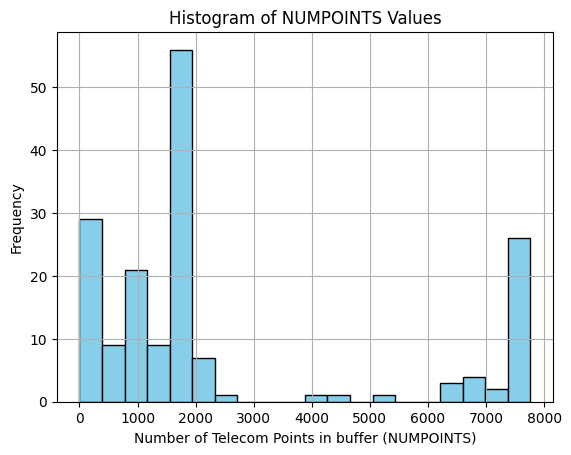

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Replace 'output_school_buffers.shp' with the actual filename of your output shapefile
output_school_buffers_path = '/content/output_school_buffers.shp'

# Read the output school buffers shapefile
output_school_buffers_gdf = gpd.read_file(output_school_buffers_path)

# Extract the 'NUMPOINTS' column values as a list
num_points_values = output_school_buffers_gdf['NUMPOINTS'].tolist()

# Create a histogram of the 'NUMPOINTS' values
plt.hist(num_points_values, bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Number of Telecom Points in buffer (NUMPOINTS)')
plt.ylabel('Frequency')
plt.title('Histogram of NUMPOINTS Values')
plt.grid(True)
plt.show()


# H3 spatial indexing

H3 is a geospatial indexing system that partitions the world into hexagonal cells. H3 is open source under the Apache 2 license.
The H3 Core Library implements the H3 grid system. It includes functions for converting from latitude and longitude coordinates to the containing H3 cell, finding the center of H3 cells, finding the boundary geometry of H3 cells, finding neighbors of H3 cells, and more.

[![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://www.youtube.com/watch?v=1Ocw_oaw_a8)[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/uber/h3/tree/master)


In [ ]:
!pip install h3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 8.3 MB/s eta 0:00:00


In [ ]:
import geopandas as gpd
import folium
import numpy as np
import h3

# Replace 'output_school_buffers.shp' with the actual filename of your output shapefile
output_school_buffers_path = '/content/output_school_buffers.shp'
admin_boundary_path = '/content/data/uttarakhand_admin_1.shp'

# Read the output school buffers shapefile and admin boundary shapefile
output_school_buffers_gdf = gpd.read_file(output_school_buffers_path)
admin_boundary_gdf = gpd.read_file(admin_boundary_path)

# Create a Folium map centered at the calculated center with the specified zoom
map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]
map_zoom = 8.5  # Adjust the zoom level as needed
m = folium.Map(location=map_center, zoom_start=map_zoom)

# Extract 'NUMPOINTS' values from the school buffers GeoDataFrame
num_points_values = output_school_buffers_gdf['NUMPOINTS'].tolist()

# Define the gradient ranges and corresponding colors
gradient_ranges = [0, 10, 100, 1000, 3000, 5000, float('inf')]
gradient_colors = ['#FF0000', '#FF6600', '#FFCC00', '#99FF00', '#33CC33', '#009933', '#006600']

# Create an H3 spatial index for each school buffer using the 'NUMPOINTS' values
h3_indices = []
for idx, row in output_school_buffers_gdf.iterrows():
    num_points = row['NUMPOINTS']
    # Determine the color based on the gradient range
    color = gradient_colors[next(i for i, range_max in enumerate(gradient_ranges) if num_points <= range_max) - 1]
    # Get the H3 index at a specific resolution (adjust the resolution as needed)
    h3_index = h3.geo_to_h3(row.geometry.centroid.y, row.geometry.centroid.x, resolution=6)  # Adjust the resolution as needed
    h3_indices.append((h3_index, color))

# Create a list of unique H3 indices and their colors
unique_h3_indices = list(set(h3_index for h3_index, _ in h3_indices))
unique_h3_colors = {h3_index: color for h3_index, color in h3_indices}

# Add H3 hexagons with colors to the map
for h3_index in unique_h3_indices:
    color = unique_h3_colors[h3_index]
    hexagon_geometry = h3.h3_to_geo_boundary(h3_index)
    hexagon_polygon = folium.Polygon(locations=hexagon_geometry, color='black', fill_color=color, fill_opacity=0.7)
    hexagon_polygon.add_to(m)

# Add the admin boundary to the map
folium.GeoJson(admin_boundary_gdf).add_to(m)

# Create a custom HTML legend
legend_html = """
<div style="position: fixed; bottom: 50px; left: 50px; z-index: 1000; background-color: white; padding: 10px; border: 2px solid gray; border-radius: 5px;">
  <p><strong>Legend</strong></p>
  <p><i class="fa fa-square" style="color:#FF0000;"></i> Very Poor</p>
  <p><i class="fa fa-square" style="color:#FF6600;"></i> Poor</p>
  <p><i class="fa fa-square" style="color:#FFCC00;"></i> Average</p>
  <p><i class="fa fa-square" style="color:#99FF00;"></i> Good</p>
  <p><i class="fa fa-square" style="color:#33CC33;"></i> Very Good</p>
  <p><i class="fa fa-square" style="color:#009933;"></i> Excellent</p>
</div>
"""

# Add the legend to the map
legend = folium.Element(legend_html)
m.get_root().html.add_child(legend)

# Display the map
m

<ipython-input-8-cfae8921339c>:15: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  map_center = [admin_boundary_gdf['geometry'].centroid.y.mean(), admin_boundary_gdf['geometry'].centroid.x.mean()]
